# <a class="anchor" id="1"></a> Description de l'entreprise et du sujet 

Notre client est une entreprise que l’on appellera X. Cette entreprise développe un service de
messagerie à destination des sociétés, leur permettant de communiquer avec leurs clients,
partenaires et fournisseurs (par l’envoi de messages et documents). X propose à ses clients son
service moyennant une rémunération à l’usage, proportionnelle au nombre de messages envoyés
par ses clients.


X nous annonce que son chiffre d’affaires est en décroissance, et souhaite que nous l’aidions à mieux
comprendre l’état actuel de son activité et de son portefeuille clients

1) Le premier objectif est d’analyser et quantifier l’évolution de l’activité suivant deux indicateurs
principaux :
- L’évolution du volume de messages envoyés
- L’évolution du nombre de clients actifs (on considère qu’un client actif est un client qui
envoie au moins un message)
L’idée est de construire des métriques clés suivant ces deux indicateurs et les représenter
visuellement grâce à des restitutions graphiques, de sorte à donner de la visibilité immédiate sur les
tendances globales.


2) Le deuxième objectif est de décrire le portefeuille client de la société X à partir des informations
suivantes :
- La taille de l’entreprise (nombre d’employés)
- Le secteur de l’entreprise (code Naf)
- La localisation de l’entreprise (département)
On souhaite ici avoir une approche exploratoire permettant d’identifier des pistes de segmentation
clients. Concrètement, on va vouloir déterminer si certaines caractéristiques clients (parmi les trois
mentionnées) expliquent une dynamique d’activité (hausse/baisse/stabilité).

# <a class="anchor" id="2"></a> Import des données et packages

## <a class="anchor" id="2.1"></a>Packages loading

In [1]:
import numpy as np 
import pandas as pd 
import seaborn as sns 
import matplotlib.pyplot as plt 
import plotly.express as px
import plotly.graph_objs as go
import sqlalchemy
import sqlite3
import os 

## <a class="anchor" id="2.2"></a> Data loading 

In [2]:
messages2019 = pd.read_excel('Flux_messages_2019.xlsx')
messages2020 = pd.read_excel('Flux_messages_2020.xlsx')
code_naf = pd.read_excel('Detail_Code_Naf.xlsx')
departement_detail = pd.read_excel('Detail_departement.xlsx')

/opt/anaconda3/lib/python3.9/site-packages/openpyxl/styles/stylesheet.py:226: UserWarning: Workbook contains no default style, apply openpyxl's default
  warn("Workbook contains no default style, apply openpyxl's default")


# Analyse de Data Quality

## Head of tables 

In [5]:
messages2019.head(1)

,ID_CONTRAT,ID_CLIENT,DEP,NB_EMPLOYEES_CLIENT,Code_Naf,2019_1_Messages,2019_2_Messages,2019_3_Messages,2019_4_Messages,2019_5_Messages,2019_6_Messages,2019_7_Messages,2019_8_Messages,2019_9_Messages,2019_10_Messages,2019_11_Messages,2019_12_Messages
0,6676990.0,6aa6485f53022aa0bd2955e6b31476e1,64.0,15.0,4661Z,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [6]:
messages2020.head(1)

,ID_CONTRAT,ID_CLIENT,DEP,NB_EMPLOYEES_CLIENT,Code_Naf,2020_1_Messages,2020_2_Messages,2020_3_Messages,2020_4_Messages,2020_5_Messages,2020_6_Messages,2020_7_Messages,2020_8_Messages,2020_9_Messages,2020_10_Messages,2020_11_Messages,2020_12_Messages
0,6677787.0,9d8959b4707a81d2bf44332eb5d471ff,83.0,0.0,7911Z,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [7]:
code_naf.head(1)

,Code_Naf,Code_Naf_Desc,Section Desc,Division Desc
0,0111Z,"Culture de céréales (à l'exception du riz), de...","AGRICULTURE, SYLVICULTURE ET PÊCHE","Culture et production animale, chasse et servi..."


In [6]:
departement_detail.head(1)

,Code Département,Code Département INSEE,Département,Code Région,Région,geo_point_2d
0,1.0,1.0,AIN,82.0,RHONE-ALPES,"46.3471891747,6.04650555568"


## Structure Types, NA.. Duplicatas

### Shape

In [7]:
messages2019.shape

(108185, 17)

In [8]:
messages2020.shape

(108185, 17)

In [9]:
departement_detail.shape

(101, 6)

In [10]:
code_naf.shape

(678, 4)

### Types 

In [11]:
messages2019.dtypes 

ID_CONTRAT             float64
ID_CLIENT               object
DEP                    float64
NB_EMPLOYEES_CLIENT    float64
Code_Naf                object
2019_1_Messages        float64
2019_2_Messages        float64
2019_3_Messages        float64
2019_4_Messages        float64
2019_5_Messages        float64
2019_6_Messages        float64
2019_7_Messages        float64
2019_8_Messages        float64
2019_9_Messages        float64
2019_10_Messages       float64
2019_11_Messages       float64
2019_12_Messages       float64
dtype: object

### Valeurs NA 

In [12]:
messages2019.isna().sum()

ID_CONTRAT               0
ID_CLIENT                0
DEP                    739
NB_EMPLOYEES_CLIENT      0
Code_Naf                84
2019_1_Messages          0
2019_2_Messages          0
2019_3_Messages          0
2019_4_Messages          0
2019_5_Messages          0
2019_6_Messages          0
2019_7_Messages          0
2019_8_Messages          0
2019_9_Messages          0
2019_10_Messages         0
2019_11_Messages         0
2019_12_Messages         0
dtype: int64

In [13]:
messages2020.isna().sum()

ID_CONTRAT               0
ID_CLIENT                0
DEP                    739
NB_EMPLOYEES_CLIENT      0
Code_Naf                84
2020_1_Messages          0
2020_2_Messages          0
2020_3_Messages          0
2020_4_Messages          0
2020_5_Messages          0
2020_6_Messages          0
2020_7_Messages          0
2020_8_Messages          0
2020_9_Messages          0
2020_10_Messages         0
2020_11_Messages         0
2020_12_Messages         0
dtype: int64

### Duplicatas 

In [14]:
# 50 lignes en doublons 
len(messages2019)-len(messages2019.drop_duplicates())

50

In [33]:
# total duplicated rows counted by id_client in messages2019
messages2019[messages2019.duplicated(keep=False)].sort_values(by='ID_CLIENT')\
                                                 .groupby('ID_CLIENT')\
                                                 .size()\
                                                 .sort_values(ascending=False)\
                                                 .to_frame(name='size')

,size
ID_CLIENT,
6577f5418c3620896193bb8e6dc05a12,12
909fed0564bb39263478eb48657a04ee,4
00ae4f5d86472a3e11f2a06e1fd9a16b,2
a6b0e40cadaea138d5fc847337116e3f,2
a6cd71b1061df4e7ef98411100388fba,2
a7024bf51e415ced1e27deb06b7820a0,2
acdfcb1d0d05e022da1e0330351f81cd,2
ae83134002e718ca8e7b2933bfe02823,2
b178f42237e17e255566ecd5decb04f0,2


In [31]:
# total duplicated rows counted by id_client in messages2020
messages2020[messages2020.duplicated(keep=False)].sort_values(by='ID_CLIENT')\
                                                 .groupby('ID_CLIENT')\
                                                 .size()\
                                                 .sort_values(ascending=False)\
                                                 .to_frame(name='size')[:4]

,size
ID_CLIENT,
6577f5418c3620896193bb8e6dc05a12,12
909fed0564bb39263478eb48657a04ee,4
8fd40a888e8d48a26f9e3c69d8e4419b,2
94a24fd8f866419b26b7769395562f6b,2


In [174]:
messages2019.query('ID_CLIENT == "00ae4f5d86472a3e11f2a06e1fd9a16b"')

,ID_CONTRAT,ID_CLIENT,DEP,NB_EMPLOYEES_CLIENT,Code_Naf,2019_1_Messages,2019_2_Messages,2019_3_Messages,2019_4_Messages,2019_5_Messages,2019_6_Messages,2019_7_Messages,2019_8_Messages,2019_9_Messages,2019_10_Messages,2019_11_Messages,2019_12_Messages
62988,7120038.0,00ae4f5d86472a3e11f2a06e1fd9a16b,87.0,2.0,6820B,3150.0,2470.0,3935.0,3325.0,3280.0,3865.0,4850.0,1455.0,6940.0,2110.0,3925.0,3860.0
66381,7120038.0,00ae4f5d86472a3e11f2a06e1fd9a16b,87.0,2.0,6820B,3150.0,2470.0,3935.0,3325.0,3280.0,3865.0,4850.0,1455.0,6940.0,2110.0,3925.0,3860.0


In [175]:
messages2020.query('ID_CLIENT == "00ae4f5d86472a3e11f2a06e1fd9a16b"')

,ID_CONTRAT,ID_CLIENT,DEP,NB_EMPLOYEES_CLIENT,Code_Naf,2020_1_Messages,2020_2_Messages,2020_3_Messages,2020_4_Messages,2020_5_Messages,2020_6_Messages,2020_7_Messages,2020_8_Messages,2020_9_Messages,2020_10_Messages,2020_11_Messages,2020_12_Messages
9943,7120038.0,00ae4f5d86472a3e11f2a06e1fd9a16b,87.0,2.0,6820B,2390.0,1380.0,3240.0,1480.0,1735.0,2550.0,2410.0,1850.0,2770.0,1730.0,1955.0,2855.0
61795,7120038.0,00ae4f5d86472a3e11f2a06e1fd9a16b,87.0,2.0,6820B,2390.0,1380.0,3240.0,1480.0,1735.0,2550.0,2410.0,1850.0,2770.0,1730.0,1955.0,2855.0


## Description informative des données 

### Secteur d'activité du client

In [195]:
# enlevons les doublons entier pour la suite de l'analyse  
messages2019.drop_duplicates(inplace=True)
messages2020.drop_duplicates(inplace=True)

messages2019.groupby(['ID_CLIENT','ID_CONTRAT'])['Code_Naf'].count().sort_values(ascending=False)

ID_CLIENT                         ID_CONTRAT
e73ea2c7024e6f93c3908d0045fd613f  7121195.0     2
7bd0698a2b016586c48eaba43565d1c7  7121166.0     2
b4411f8eef7e317d73bcc5314229f177  7093443.0     2
475f68f91d4670a4ca764dcdf7c8e2fa  7121198.0     2
51e0e80c260d82688be784b28bc163db  7121218.0     2
                                               ..
0d89aedb721ef2f95903454104ba38ed  7098723.0     0
68aa2a504fc44e04d94c4d789ceaa634  7101864.0     0
a1ec173167722b8faed15b7608260b27  7109771.0     0
6978576814ad3c6f822f4ef9a11c194f  7314386.0     0
9de7fe0c02aaa68fcb19c43cb3f11aeb  7108825.0     0
Name: Code_Naf, Length: 108120, dtype: int64

In [196]:
# nb_sector of activity by client
messages2019.groupby('ID_CLIENT')['Code_Naf'].apply(lambda x : set(x))\
                                     .apply(lambda x: len(x))\
                                     .sort_values(ascending=False)

ID_CLIENT
f4f8caa378a81992465e04692eee83ef    12
6b5ffa17acb62399dab7059f5a7f10a5     7
4c51a2e7508c505d723881499bfac05e     7
7982701799bbbb3add17ca96208eed64     7
fb807f99e7f1e335ae704a67598fb029     7
                                    ..
568a08cf988a4d6dfb56120c4e1fed16     1
568a1e5bbd8d3706976101ec61c019aa     1
568af8752e044a09bc03c846e9ccf86b     1
568afe61e0b1fceda4b7cd7048f00b01     1
ffff7f779abe5f214fd1d34f90622954     1
Name: Code_Naf, Length: 65133, dtype: int64

In [197]:
# nb_sector of activity by client
messages2020.groupby('ID_CLIENT')['Code_Naf'].apply(lambda x : set(x))\
                                     .apply(lambda x: len(x))\
                                     .sort_values(ascending=False)

ID_CLIENT
f4f8caa378a81992465e04692eee83ef    12
6b5ffa17acb62399dab7059f5a7f10a5     7
4c51a2e7508c505d723881499bfac05e     7
7982701799bbbb3add17ca96208eed64     7
fb807f99e7f1e335ae704a67598fb029     7
                                    ..
568a08cf988a4d6dfb56120c4e1fed16     1
568a1e5bbd8d3706976101ec61c019aa     1
568af8752e044a09bc03c846e9ccf86b     1
568afe61e0b1fceda4b7cd7048f00b01     1
ffff7f779abe5f214fd1d34f90622954     1
Name: Code_Naf, Length: 65133, dtype: int64

In [198]:
(messages2019.groupby('ID_CLIENT')['Code_Naf'].apply(lambda x : set(x))\
                                     .apply(lambda x: len(x))\
                                     .sort_values(ascending=False)>1).sum()

1287

In [199]:
((messages2019.groupby('ID_CLIENT')['Code_Naf'].apply(lambda x : set(x))\
                                     .apply(lambda x: len(x))\
                                     .sort_values(ascending=False)>1).sum()/len(set(messages2019['ID_CLIENT'])))*100

1.9759568882133478

**Seulement 2 % des clients ont plus d'1 secteurs d'activité cela est à prendre en compte dans la modélisation**

### Étude de Cardinalité :  ID_Contrat VS ID_CLIENT

Un client peut avoir plusieurs contrats mais également plusieurs secteurs d'activité ainsi ce qui constitue 

In [200]:
# comprendre la relation entre un contrat et un client 
messages2019.groupby('ID_CLIENT')['ID_CONTRAT'].apply(lambda x : set(x))\
                                     .apply(lambda x: len(x))\
                                     .sort_values(ascending=False)

ID_CLIENT
bb1d38cd1aa892b43303a2e00cb4b30e    511
d2acad4230cc2b103e264e015060a73f    354
c4b7151198ebb4b0e45d8cfd5ac8314e    286
9cd193df667c5f07b784b4a989ff62d7    266
9e9aac77ea910a5526204524acfa337f    261
                                   ... 
654f9b27be26d957fb1fb039ce16f718      1
65501d46e324c1cde8ee4ae42b73b904      1
6552ff2d69b13fd1a6465cf9356eaee6      1
6553fc9d87f114ec1c651dc8c3cfe42f      1
8055a39f2626af6ee326c4a0089d6757      1
Name: ID_CONTRAT, Length: 65133, dtype: int64

In [201]:
messages2020.groupby('ID_CLIENT')['ID_CONTRAT'].apply(lambda x : set(x))\
                                     .apply(lambda x: len(x))\
                                     .sort_values(ascending=False)

ID_CLIENT
bb1d38cd1aa892b43303a2e00cb4b30e    511
d2acad4230cc2b103e264e015060a73f    354
c4b7151198ebb4b0e45d8cfd5ac8314e    286
9cd193df667c5f07b784b4a989ff62d7    266
9e9aac77ea910a5526204524acfa337f    261
                                   ... 
654f9b27be26d957fb1fb039ce16f718      1
65501d46e324c1cde8ee4ae42b73b904      1
6552ff2d69b13fd1a6465cf9356eaee6      1
6553fc9d87f114ec1c651dc8c3cfe42f      1
8055a39f2626af6ee326c4a0089d6757      1
Name: ID_CONTRAT, Length: 65133, dtype: int64

In [203]:
messages2020.groupby('ID_CONTRAT')['ID_CLIENT'].count().sort_values(ascending=False)

ID_CONTRAT
7088441.0    2
7093462.0    2
7121251.0    2
7093441.0    2
7121217.0    2
            ..
7089223.0    1
7089222.0    1
7089221.0    1
7089220.0    1
9660310.0    1
Name: ID_CLIENT, Length: 108115, dtype: int64

In [40]:
len(messages2019['ID_CONTRAT'].unique())

108115

In [39]:
len(messages2019)

108185

### Département du client

In [204]:
(messages2020.groupby(['ID_CLIENT','ID_CONTRAT'])['DEP'].apply(lambda x : set(x))\
                                     .apply(lambda x: len(x))\
                                     .sort_values(ascending=False))

ID_CLIENT                         ID_CONTRAT
00013decaccc1dd6ea5f715c3a4306df  7306979.0     1
ac18ae4693ebd9891d710c8df3b0a2e8  7313812.0     1
ac226c591ec8b6de78998745e5453ce0  7111972.0     1
                                  7111971.0     1
                                  7111970.0     1
                                               ..
57742e810e87b49762c487e6015630a3  7087462.0     1
5773942fff6e8592041d8ffa4640e839  7097577.0     1
577292341b79d7453de85202f2c5f044  7081508.0     1
577255c784d5e9e881287236f8793938  7712667.0     1
ffff7f779abe5f214fd1d34f90622954  7109957.0     1
Name: DEP, Length: 108120, dtype: int64

**Il y'a bien un contrat par departement par client pas de traitement de cardinalité**

In [206]:
(messages2020.groupby('ID_CLIENT')['DEP'].apply(lambda x : set(x))\
                                     .apply(lambda x: len(x))\
                                     .sort_values(ascending=False)>1).sum()

123

In [207]:
((messages2020.groupby('ID_CLIENT')['DEP'].apply(lambda x : set(x))\
                                     .apply(lambda x: len(x))\
                                     .sort_values(ascending=False)>1).sum()/len(set(messages2020['ID_CLIENT'])))*100

0.1888443646078025

## NB employees du client 

In [214]:
messages2019.groupby(['ID_CONTRAT','ID_CLIENT'])['NB_EMPLOYEES_CLIENT'].count().sort_values(ascending=False)

ID_CONTRAT  ID_CLIENT                       
7093443.0   b4411f8eef7e317d73bcc5314229f177    2
7093441.0   7e8939fb06151f172870f063cee77324    2
7121198.0   475f68f91d4670a4ca764dcdf7c8e2fa    2
7121195.0   e73ea2c7024e6f93c3908d0045fd613f    2
7121166.0   7bd0698a2b016586c48eaba43565d1c7    2
                                               ..
7089224.0   83482a732d82315e8a89ba66568680f4    1
7089223.0   9dd1c2c1095f9d24010078622937eea7    1
7089222.0   d24d16f8ad772b3c54e5ec15902920a8    1
7089221.0   f2f10fa11c88e667a7ff240661e97d4e    1
9660310.0   bb1d38cd1aa892b43303a2e00cb4b30e    1
Name: NB_EMPLOYEES_CLIENT, Length: 108120, dtype: int64

In [210]:
messages2019.query('''ID_CLIENT == "b4411f8eef7e317d73bcc5314229f177" and ID_CONTRAT == 7093443.0
                   
                   ''')

,ID_CONTRAT,ID_CLIENT,DEP,NB_EMPLOYEES_CLIENT,Code_Naf,2019_1_Messages,2019_2_Messages,2019_3_Messages,2019_4_Messages,2019_5_Messages,2019_6_Messages,2019_7_Messages,2019_8_Messages,2019_9_Messages,2019_10_Messages,2019_11_Messages,2019_12_Messages
44195,7093443.0,b4411f8eef7e317d73bcc5314229f177,75.0,283.0,4221Z,6200.0,3300.0,480.0,7070.0,860.0,7130.0,3740.0,4765.0,3505.0,1940.0,2295.0,6445.0
45954,7093443.0,b4411f8eef7e317d73bcc5314229f177,75.0,20.0,4221Z,6200.0,3300.0,480.0,7070.0,860.0,7130.0,3740.0,4765.0,3505.0,1940.0,2295.0,6445.0


**1 er cas :** Sur un même (contrat_ID, client_ID, Code Naf) j'ai deux volumes d'employés différents mais des volumes messages identiques 

In [220]:
messages2019.query('''ID_CLIENT == "3773cdd8cda1eadcaa7b4eed1434f8fb" and ID_CONTRAT == 7088458.0 
                   ''')

,ID_CONTRAT,ID_CLIENT,DEP,NB_EMPLOYEES_CLIENT,Code_Naf,2019_1_Messages,2019_2_Messages,2019_3_Messages,2019_4_Messages,2019_5_Messages,2019_6_Messages,2019_7_Messages,2019_8_Messages,2019_9_Messages,2019_10_Messages,2019_11_Messages,2019_12_Messages
39907,7088458.0,3773cdd8cda1eadcaa7b4eed1434f8fb,74.0,29.0,2790Z,300.0,400.0,270.0,380.0,210.0,220.0,400.0,180.0,350.0,260.0,410.0,180.0
40405,7088458.0,3773cdd8cda1eadcaa7b4eed1434f8fb,74.0,29.0,2790Z,150.0,200.0,135.0,190.0,105.0,110.0,200.0,90.0,175.0,130.0,205.0,90.0


**2 ème cas :** Sur un même (contrat_ID, client_ID, Code Naf) j'ai deux volumes différents mais des volumes messages différents

In [219]:
messages2019[messages2019.duplicated(subset=['ID_CONTRAT',
                                             'ID_CLIENT',
                                             'Code_Naf'],
                                             keep=False)]\
                                             .sort_values(by=['ID_CLIENT'])

,ID_CONTRAT,ID_CLIENT,DEP,NB_EMPLOYEES_CLIENT,Code_Naf,2019_1_Messages,2019_2_Messages,2019_3_Messages,2019_4_Messages,2019_5_Messages,2019_6_Messages,2019_7_Messages,2019_8_Messages,2019_9_Messages,2019_10_Messages,2019_11_Messages,2019_12_Messages
43609,7093458.0,31d79e45244dadc36dfb4e22b97adc6d,8.0,20.0,8899B,2575.0,6620.0,2655.0,4760.0,1650.0,1375.0,2355.0,1405.0,1180.0,1390.0,2375.0,3585.0
45958,7093458.0,31d79e45244dadc36dfb4e22b97adc6d,8.0,0.0,8899B,2575.0,6620.0,2655.0,4760.0,1650.0,1375.0,2355.0,1405.0,1180.0,1390.0,2375.0,3585.0
39907,7088458.0,3773cdd8cda1eadcaa7b4eed1434f8fb,74.0,29.0,2790Z,300.0,400.0,270.0,380.0,210.0,220.0,400.0,180.0,350.0,260.0,410.0,180.0
40405,7088458.0,3773cdd8cda1eadcaa7b4eed1434f8fb,74.0,29.0,2790Z,150.0,200.0,135.0,190.0,105.0,110.0,200.0,90.0,175.0,130.0,205.0,90.0
58744,7111561.0,41f4c5d79f6d6eb217d559a6ac64a34b,75.0,20.0,8559A,2745.0,2150.0,2810.0,1575.0,2010.0,1600.0,1990.0,2185.0,1235.0,2920.0,985.0,910.0
58719,7111561.0,41f4c5d79f6d6eb217d559a6ac64a34b,75.0,10.0,8559A,2745.0,2150.0,2810.0,1575.0,2010.0,1600.0,1990.0,2185.0,1235.0,2920.0,985.0,910.0
67754,7121198.0,475f68f91d4670a4ca764dcdf7c8e2fa,49.0,1.0,8413Z,10205.0,8045.0,15210.0,7295.0,9130.0,6260.0,1505.0,5985.0,7720.0,6950.0,4955.0,6280.0
67753,7121198.0,475f68f91d4670a4ca764dcdf7c8e2fa,49.0,100.0,8413Z,10205.0,8045.0,15210.0,7295.0,9130.0,6260.0,1505.0,5985.0,7720.0,6950.0,4955.0,6280.0
44232,7093462.0,535e79532cccf84689f310ee3695c8a9,75.0,20.0,4631Z,695.0,705.0,720.0,705.0,750.0,780.0,830.0,630.0,685.0,780.0,755.0,730.0
44233,7093462.0,535e79532cccf84689f310ee3695c8a9,75.0,250.0,4631Z,695.0,705.0,720.0,705.0,750.0,780.0,830.0,630.0,685.0,780.0,755.0,730.0


### Conclusion de la description informative 

Un client peut avoir plusieurs contrats, il faut donc faire attention quand on veut comptabilisé le nombre de clients actifs

**Hypothèse : est-ce que le nombre de contrat à un impact sur le CA généré par le client ?** 

(Sachant que le CA est alpha-proportionnelle aux nombres de messages généré)

Nous avons pas d'informations sur les typologies des contrats, il serait intéressant de créer une colonne 'NB_contrat' pour y intégrer le nombre de contrat du client.

Est-ce que pour le pilotage de l'activité pour le client est important de resté sur la granularité contrat, il y'a des produits plus générateur de valeurs que d'autres, identifier des contrats fort/faible.

(EX : Sur quelle typologie de produit avons nous le plus de churn ou le moins de ROI ?)

Avec les données dont nous disposons l'id_contrat ne représentent pas d'information en tant que tel nous prenons donc le pivot de modéliser cette id en KPI.


**Shortlist des variables explicatives :**

- id_client 
- nb_contrat 
- typologies secteur d'activité (mono/poly)
- Liste des codes Naf - code Naf 
- Dep
- Typologie géographique du client(mono/poly)
- Volume messages
- Mois 
- Années 
- Nouvel arrivant ?
- Actif mois-dernier 
- Fantôme 

Générer une table qui pilote par mois l'activité du client
et qui alimentera le devellopement des modèles ML


Pour cela nous devons produire une clé primaire qui nous permettra de représenter 1 client et joindre les tables avec de la cohérence.


# Data Processing

Objectif : construire une table verticale sur laquelle on aura année, mois, nb_messages, actif 

In [14]:
messages2019.head(1)

,ID_CONTRAT,ID_CLIENT,DEP,NB_EMPLOYEES_CLIENT,Code_Naf,2019_1_Messages,2019_2_Messages,2019_3_Messages,2019_4_Messages,2019_5_Messages,2019_6_Messages,2019_7_Messages,2019_8_Messages,2019_9_Messages,2019_10_Messages,2019_11_Messages,2019_12_Messages
0,6676990.0,6aa6485f53022aa0bd2955e6b31476e1,64.0,15.0,4661Z,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### Génération de la clé de jointure 

In [15]:
messages2019[messages2019.duplicated(subset=['ID_CONTRAT',
                                             'ID_CLIENT',
                                             'Code_Naf'],
                                             keep=False)]\
                                             .sort_values(by=['ID_CLIENT'])

,ID_CONTRAT,ID_CLIENT,DEP,NB_EMPLOYEES_CLIENT,Code_Naf,2019_1_Messages,2019_2_Messages,2019_3_Messages,2019_4_Messages,2019_5_Messages,2019_6_Messages,2019_7_Messages,2019_8_Messages,2019_9_Messages,2019_10_Messages,2019_11_Messages,2019_12_Messages
66381,7120038.0,00ae4f5d86472a3e11f2a06e1fd9a16b,87.0,2.0,6820B,3150.0,2470.0,3935.0,3325.0,3280.0,3865.0,4850.0,1455.0,6940.0,2110.0,3925.0,3860.0
62988,7120038.0,00ae4f5d86472a3e11f2a06e1fd9a16b,87.0,2.0,6820B,3150.0,2470.0,3935.0,3325.0,3280.0,3865.0,4850.0,1455.0,6940.0,2110.0,3925.0,3860.0
56317,7110334.0,0e5450e93649091a6d8d69f51b771d82,76.0,126.0,1920Z,0.0,0.0,0.0,0.0,1695.0,375.0,0.0,100.0,85.0,285.0,55.0,215.0
56316,7110334.0,0e5450e93649091a6d8d69f51b771d82,76.0,126.0,1920Z,0.0,0.0,0.0,0.0,1695.0,375.0,0.0,100.0,85.0,285.0,55.0,215.0
56350,7110369.0,0fb4db080da56dcdd0ed0eefd8cab71e,94.0,20.0,6820A,50.0,2070.0,4045.0,3550.0,3035.0,3505.0,4030.0,2760.0,1975.0,2625.0,3070.0,5100.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11225,7121209.0,ec9e3a08a831f4ca316d4384d776b81e,97.0,6.0,6202B,11545.0,9435.0,8785.0,11920.0,8600.0,13950.0,5390.0,10440.0,8190.0,10855.0,8990.0,10260.0
63010,7120041.0,fcbe6302fdaab57b24d26fc9936d9738,75.0,100.0,7420Z,6000.0,5180.0,11270.0,8055.0,2720.0,2545.0,4620.0,8470.0,2580.0,2685.0,2305.0,2835.0
66382,7120041.0,fcbe6302fdaab57b24d26fc9936d9738,75.0,100.0,7420Z,6000.0,5180.0,11270.0,8055.0,2720.0,2545.0,4620.0,8470.0,2580.0,2685.0,2305.0,2835.0
61604,7120046.0,fcbf1d88b3754cc5bd6ac86a9668ee13,75.0,250.0,4638B,4035.0,3915.0,3915.0,3550.0,5760.0,3290.0,3550.0,2410.0,4480.0,4280.0,3300.0,3630.0


### fonctions de Data Cleaning

In [3]:
def CleanDuplicatedValue(message):
    message['key'] = message[['ID_CLIENT','ID_CONTRAT','Code_Naf']].astype(str).sum(axis=1)
    return message.drop_duplicates()\
                   .sort_values(by='ID_CLIENT')\
                   .groupby([i for i in message.columns if i != 'NB_EMPLOYEES_CLIENT'])\
                   .sum()\
                   .reset_index()\
                   .groupby(['key','ID_CONTRAT',
                                     'ID_CLIENT',
                                     'DEP',
                                     'Code_Naf',
                                     'NB_EMPLOYEES_CLIENT']).sum()\
                   .reset_index()

def CAP_GROUP(x):
    if x < 0.1:
    	return 'Classic'
    
    else : 
    	return 'Premium'

    
def AddIndicators(messages):
    MessagesBucketVariables = [i for i in messages.columns if 'Messages' in i]

    messages = messages[['ID_CONTRAT',
                         'ID_CLIENT',
                         'DEP',
                         'Code_Naf',
                         'NB_EMPLOYEES_CLIENT']+ MessagesBucketVariables]


    messages_agg_client = (messages.groupby('ID_CLIENT')['DEP'].apply(lambda x:list(set(x)))).to_frame()\
          .join(\
                messages.groupby('ID_CLIENT')['ID_CONTRAT']\
                        .count().to_frame(name='NB_CONTRAT'))\
          .join(\
                messages.groupby('ID_CLIENT')['Code_Naf']\
                         .apply(lambda x:list(set(x))).to_frame(name='Liste_Code_Naf'))\
          .join(\
                messages.groupby('ID_CLIENT')[['NB_EMPLOYEES_CLIENT']+ MessagesBucketVariables]\
                         .sum())

    messages_agg_client['MESSAGE_TOTALE'] = messages_agg_client[MessagesBucketVariables].sum(axis=1)

    messages_agg_client['MESSAGE_RISQUE'] = messages_agg_client[MessagesBucketVariables].std(axis=1)

    messages_agg_client['MESSAGE_MOYEN'] = messages_agg_client[MessagesBucketVariables].mean(axis=1)

    messages_agg_client['MESSAGE_MEDIAN'] = messages_agg_client[MessagesBucketVariables].median(axis=1)


    # on garde uniquement les clients qui ont au moins 10 messages 

    messages_agg_client = messages_agg_client.query('MESSAGE_TOTALE >=10')

    messages_agg_client.sort_values(by='MESSAGE_TOTALE',ascending=False,inplace=True)

    messages_agg_client['RANK'] = np.arange(len(messages_agg_client))+1

    total_message = messages_agg_client['MESSAGE_TOTALE'].sum()

    messages_agg_client = messages_agg_client\
                         .assign(PERCENT_RANK = lambda x:1-((x.RANK-1)/(len(messages_agg_client)-1)))\
                         .assign(MARKET_CAP =  lambda x:(x.MESSAGE_TOTALE / total_message)*100)\
                         .assign(CUM_MARKET_CAP = lambda x:(x.MESSAGE_TOTALE.cumsum()/total_message)*100)

    messages_agg_client['ACTIVITY'] = messages_agg_client.apply(lambda x: (x[MessagesBucketVariables]>0).sum(),axis=1)

    messages_agg_client['ACTIVITY_RATE'] = (messages_agg_client['ACTIVITY'] /len(MessagesBucketVariables))*100

    # Formule de sharpe ratio : détermine la rentabilité d'un portefeuille
    # https://fr.wikipedia.org/wiki/Ratio_de_Sharpe
    # En posant comme r (référentiel de comparaison) message moyen par mois sur tout l'historique  
    messages_agg_client['RENTABILITY_SCORE'] = (messages_agg_client['MESSAGE_MOYEN'] -  messages_agg_client['MESSAGE_MOYEN'].mean()) / messages_agg_client['MESSAGE_RISQUE']

    messages_agg_client.insert(3, 'NB_SECTEURS',messages_agg_client['Liste_Code_Naf'].apply(lambda x : len(x)))
    
    messages_agg_client.insert(2, 'Code_Naf',messages_agg_client['Liste_Code_Naf'].apply(lambda x : x[0]))

    messages_agg_client['DEP'] = messages_agg_client['DEP'].apply(lambda x:list(x)[0])
    
    messages_agg_client['GROUP_CAP'] = messages_agg_client['MARKET_CAP'].apply(lambda x: CAP_GROUP(x))

    messages_agg_client.reset_index(inplace=True)
    
    departement_detail.drop_duplicates(subset='Code Département',keep='first',inplace=True)
    
    code_naf.drop_duplicates(subset='Code_Naf',keep='first',inplace=True)
    
    messages_agg_client = messages_agg_client.merge(departement_detail,
                                                     left_on='DEP',
                                                     right_on = 'Code Département',
                                                     how='left'
                                                     )\
                                              .merge(code_naf,
                                                     left_on='Code_Naf',
                                                     right_on = 'Code_Naf',
                                                     how='left'
                                                     )

    return messages, messages_agg_client

def loadMessage():
	try : 
    	print("i") 
        return 0
    except : 
    	print('Erreur lors du chargement des données...')

### Data Cleaning Execution 

In [4]:
messages2019, messages2020  = CleanDuplicatedValue(messages2019), CleanDuplicatedValue(messages2020)


messages = pd.merge(messages2019,
                    messages2020,
                    on=['key'],
                    how='outer',
                    validate='1:1',
                    suffixes=('', '_y'),
                    indicator=True)

print('='*50)
print(messages['_merge'].value_counts(normalize=True))
print('='*50)
print(messages.isna().sum())
print('='*50)


messages,messages_agg_client =  AddIndicators(messages)

id_vars = [i for i in messages_agg_client.columns if 'Messages' not in i]

heartbeat_messages = pd.melt(messages_agg_client, id_vars= id_vars,
                              var_name = 'Periode', 
                              value_name='NB_MESSAGES')

heartbeat_messages['Annee'] = heartbeat_messages['Periode'].apply(lambda x:x.split('_')[0]).astype(int)
heartbeat_messages['Mois']  = heartbeat_messages['Periode'].apply(lambda x:x.split('_')[1]).astype(int)
heartbeat_messages['Actif?']  = np.where(heartbeat_messages['NB_MESSAGES']==0,0,1)


heartbeat_messages.drop(['Periode','Liste_Code_Naf'],axis=1,inplace=True)

messages_agg_client.drop(['Liste_Code_Naf'],axis=1,inplace=True)

both          1.0
left_only     0.0
right_only    0.0
Name: _merge, dtype: float64
key                      0
ID_CONTRAT               0
ID_CLIENT                0
DEP                      0
Code_Naf                 0
NB_EMPLOYEES_CLIENT      0
2019_1_Messages          0
2019_2_Messages          0
2019_3_Messages          0
2019_4_Messages          0
2019_5_Messages          0
2019_6_Messages          0
2019_7_Messages          0
2019_8_Messages          0
2019_9_Messages          0
2019_10_Messages         0
2019_11_Messages         0
2019_12_Messages         0
ID_CONTRAT_y             0
ID_CLIENT_y              0
DEP_y                    0
Code_Naf_y               0
NB_EMPLOYEES_CLIENT_y    0
2020_1_Messages          0
2020_2_Messages          0
2020_3_Messages          0
2020_4_Messages          0
2020_5_Messages          0
2020_6_Messages          0
2020_7_Messages          0
2020_8_Messages          0
2020_9_Messages          0
2020_10_Messages         0
2020_11_Messages         0

/opt/anaconda3/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)
/var/folders/5d/6z528s_s09ggzk7142dgylvc0000gn/T/ipykernel_2966/1648690435.py:62: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  messages_agg_client['RANK'] = np.arange(len(messages_agg_client))+1


## DataBase Creation

In [18]:
messages.head(1)

,ID_CONTRAT,ID_CLIENT,DEP,Code_Naf,NB_EMPLOYEES_CLIENT,2019_1_Messages,2019_2_Messages,2019_3_Messages,2019_4_Messages,2019_5_Messages,...,2020_3_Messages,2020_4_Messages,2020_5_Messages,2020_6_Messages,2020_7_Messages,2020_8_Messages,2020_9_Messages,2020_10_Messages,2020_11_Messages,2020_12_Messages
0,7306979.0,00013decaccc1dd6ea5f715c3a4306df,28.0,6110Z,30.0,2330.0,1125.0,535.0,570.0,525.0,...,50.0,65.0,25.0,115.0,175.0,90.0,135.0,110.0,65.0,85.0


In [19]:
messages_agg_client.head(1)

,ID_CLIENT,DEP,NB_CONTRAT,Code_Naf,NB_SECTEURS,NB_EMPLOYEES_CLIENT,2019_1_Messages,2019_2_Messages,2019_3_Messages,2019_4_Messages,...,GROUP_CAP,Code Département,Code Département INSEE,Département,Code Région,Région,geo_point_2d,Code_Naf_Desc,Section Desc,Division Desc
0,909fed0564bb39263478eb48657a04ee,92.0,118,6311Z,1,4510.0,10371410.0,9118815.0,10347375.0,9916885.0,...,Premium,92.0,92.0,HAUTS-DE-SEINE,11.0,ILE-DE-FRANCE,"48.8960701282,2.20671346353","Traitement de données, hébergement et activité...",INFORMATION ET COMMUNICATION,Services d'information


In [20]:
heartbeat_messages.head(1)

,ID_CLIENT,DEP,NB_CONTRAT,Code_Naf,NB_SECTEURS,NB_EMPLOYEES_CLIENT,MESSAGE_TOTALE,MESSAGE_RISQUE,MESSAGE_MOYEN,MESSAGE_MEDIAN,...,Code Région,Région,geo_point_2d,Code_Naf_Desc,Section Desc,Division Desc,NB_MESSAGES,Annee,Mois,Actif?
0,909fed0564bb39263478eb48657a04ee,92.0,118,6311Z,1,4510.0,199874830.0,1.387457e+06,8.328118e+06,8407727.5,...,11.0,ILE-DE-FRANCE,"48.8960701282,2.20671346353","Traitement de données, hébergement et activité...",INFORMATION ET COMMUNICATION,Services d'information,10371410.0,2019,1,1


In [6]:
heartbeat_messages['MARKET_CAP']

0          3.045530e+00
1          2.010739e+00
2          1.640378e+00
3          1.386675e+00
4          1.323040e+00
               ...     
1366147    1.523718e-07
1366148    1.523718e-07
1366149    1.523718e-07
1366150    1.523718e-07
1366151    1.523718e-07
Name: MARKET_CAP, Length: 1366152, dtype: float64

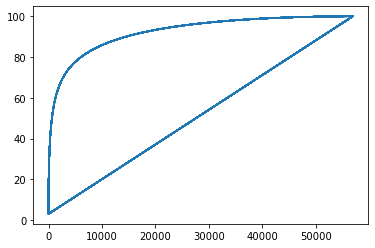

In [14]:
plt.plot(heartbeat_messages['RANK'] , heartbeat_messages['CUM_MARKET_CAP'])

In [24]:
os.getcwd()

"/Users/adham/Desktop/Candidature June Partners - Cas d'usage"

In [23]:
os.chdir("/Users/adham/Desktop/Candidature June Partners - Cas d'usage")

### Create Sqlite engine

In [5]:
engine = sqlalchemy.create_engine('sqlite:///DatabaseJune.db')

In [6]:
engine

Engine(sqlite:///DatabaseJune.db)

### Add tables in Database  

In [7]:
messages.to_sql('messages',engine,index=False,if_exists = 'replace')

In [8]:
messages_agg_client.to_sql('messages_agg_client',engine,index=False,if_exists = 'replace')

In [9]:
heartbeat_messages.to_sql('heartbeat_messages',engine,index=False,if_exists = 'replace')

## Load DATA FROM Database

In [2]:
engine = sqlalchemy.create_engine('sqlite:///DatabaseJune.db')

In [3]:
messages = pd.read_sql('SELECT * FROM messages',engine)

In [4]:
messages_agg_client = pd.read_sql('SELECT * FROM messages_agg_client',engine)

In [5]:
heartbeat_messages = pd.read_sql('SELECT * FROM heartbeat_messages',engine)

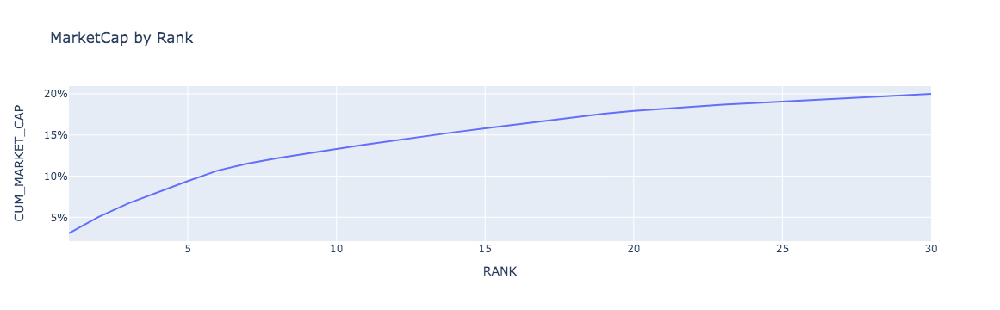

In [7]:
n = 30

fig = px.line(messages_agg_client[:n], 
             y='CUM_MARKET_CAP',
             x='RANK',
             title="MarketCap by Rank")


fig.update_layout(yaxis_ticksuffix = "%")
fig.show()

**Les 5 plus gros clients ont contribué à hauteur de 10 % du chiffre d'affaires global** 


Dans cette situation, nous avons mis en place une segmentation pour mieux comprendre les données. Nous avons identifié un segment client Premium, qui regroupe tous les clients générant individuellement plus de **0,5 %** du chiffre d'affaires global.

# Évolution de l'activité 

## Comparaison  2019/2020

### Trend Global vision 

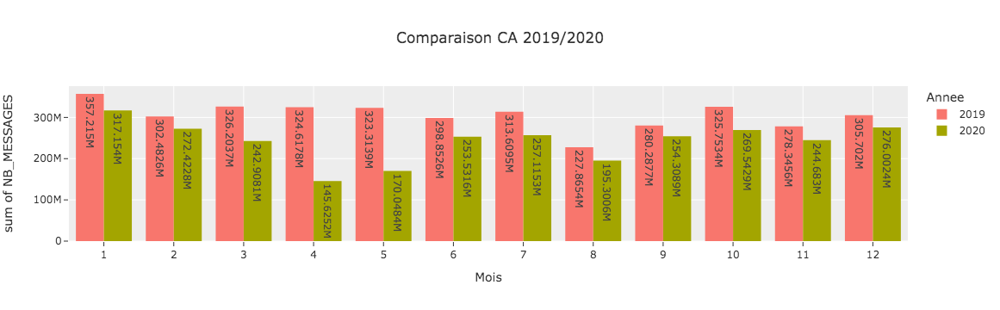

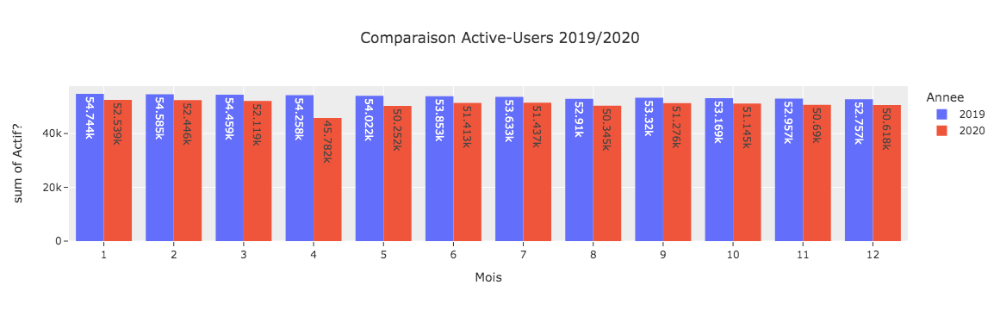

In [8]:
data = heartbeat_messages.groupby(['Annee','Mois']).sum().reset_index()

fig1 = px.histogram(data,
       x="Mois",
       y="NB_MESSAGES",
       color="Annee", 
       histfunc='sum',
       barmode='group',
       title="Comparaison CA 2019/2020",
       template='ggplot2',
       text_auto=True)


fig2 = px.histogram(data,
       x="Mois",
       y="Actif?",
       color="Annee", 
       histfunc='sum',
       barmode='group',
       title="Comparaison Active-Users 2019/2020",
       template='ggplot2',
       color_discrete_sequence=px.colors.qualitative.Plotly,
       text_auto=True)

fig1.update_layout(hovermode="x unified")
fig1.update_xaxes(type='category')

fig2.update_xaxes(type='category')
fig2.update_layout(hovermode="x unified")

fig1.show()
fig2.show()

### Analyse et hypothèses 



Nous observons des changements significatifs entre l'année 2019 et 2020, notamment une forte tendance baissière entre les mois de mars et mai 2020. Cependant, cette baisse ne semble pas être expliquée par le nombre total d'active users, car nous constatons un delta peu significatif.

Pour mieux comprendre cette baisse d'activité, il est important d'analyser les variations au niveau de la **typologie des clients**, notamment en comparant le volume d'active users et le nombre de messages entre les périodes de 2020 et 2019.

De plus, il est essentiel de croiser cette analyse avec des sources d'informations externes, telles que les périodes de la pandémie de COVID-19, qui ont pu avoir un impact sur l'activité de certains secteurs.

### Évolution du CA par secteur d'activité 

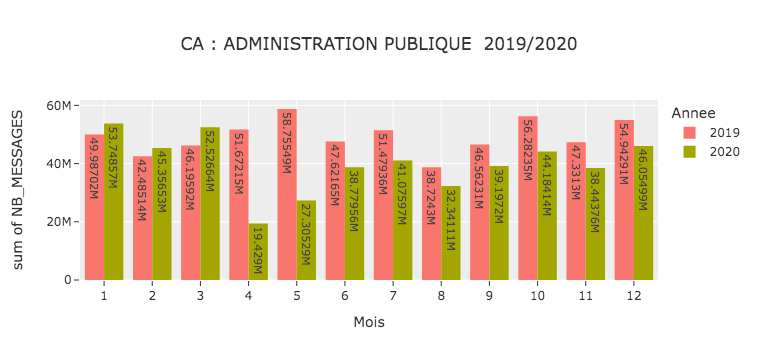

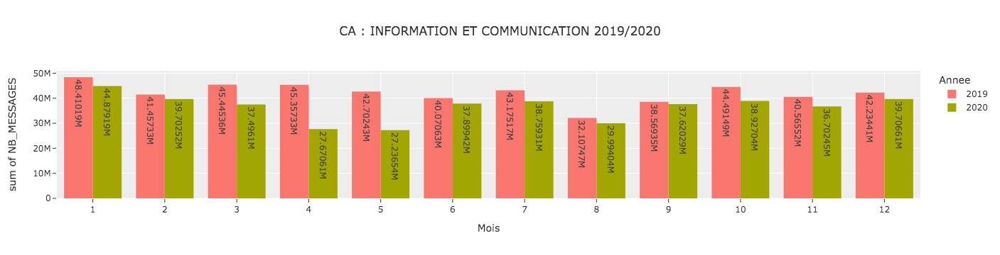

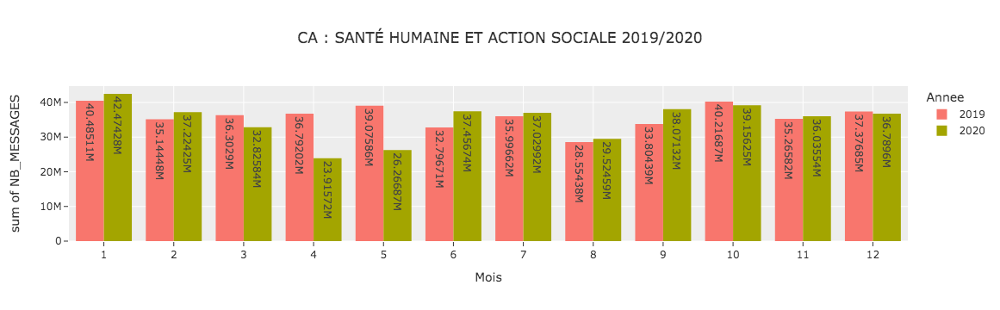

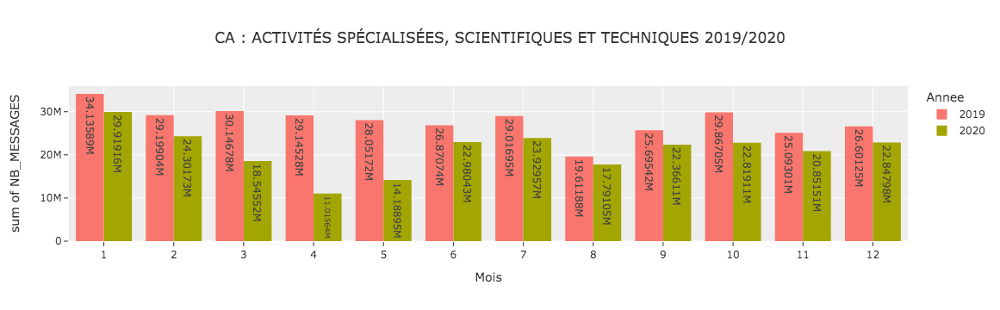

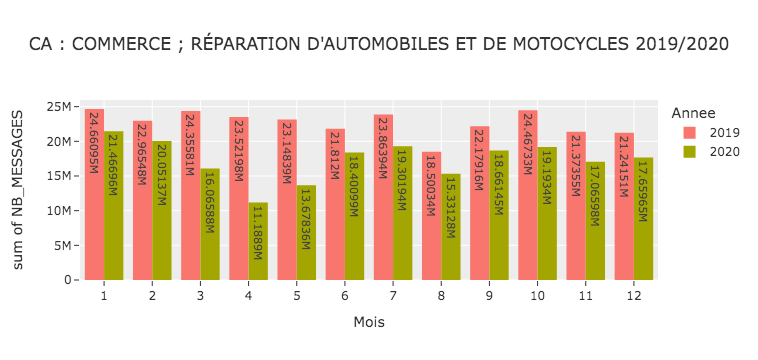

...

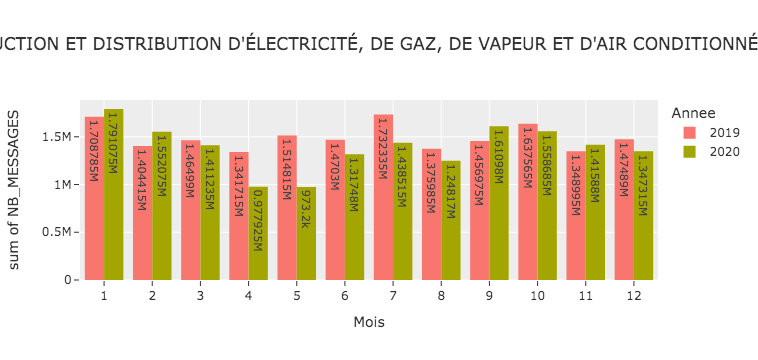

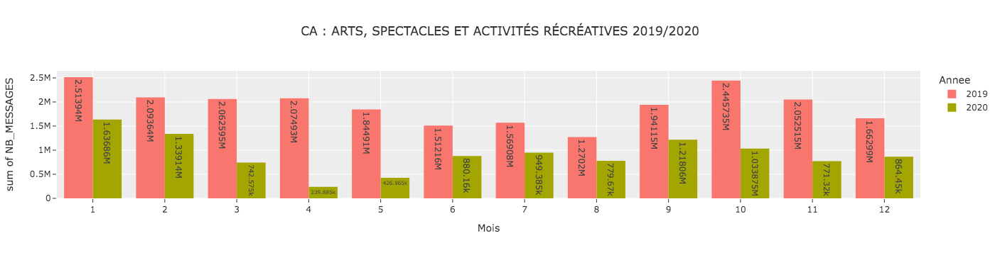

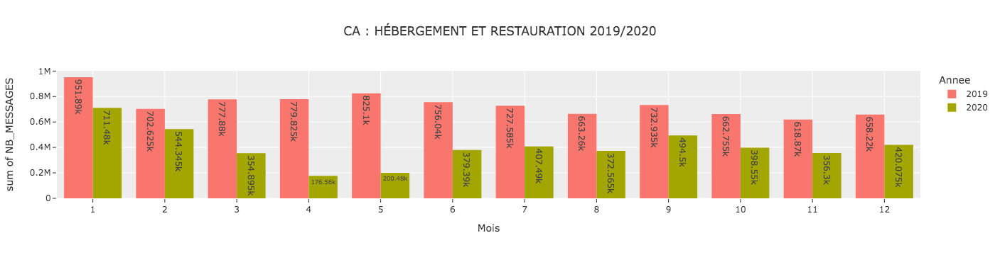

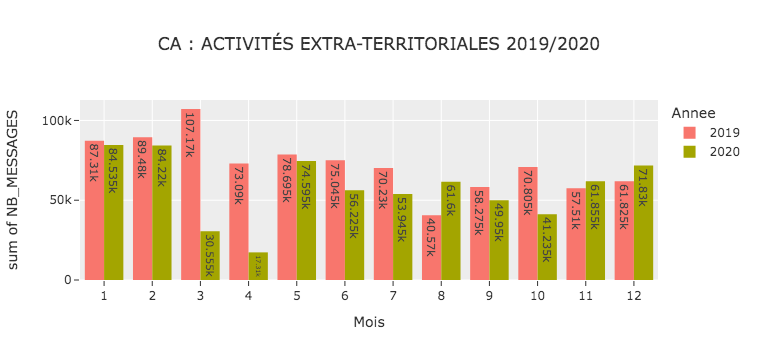

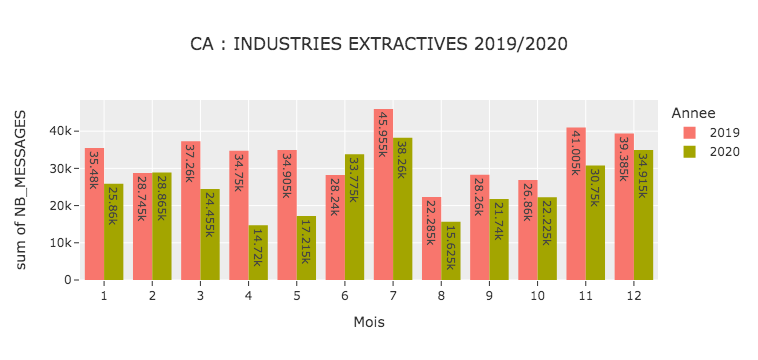

In [9]:
sections = list(messages_agg_client.groupby('Section Desc')['MESSAGE_TOTALE']\
     					.sum()\
     					.sort_values(ascending=False)\
     					.index)


data = heartbeat_messages.groupby(['Annee','Mois','Section Desc']).sum().reset_index()


for section in sections : 
    
    querydata = data.query(f""" `Section Desc` == "{str(section)}" """)  

    fig1 = px.histogram(querydata,
           x="Mois",
           y="NB_MESSAGES",
           color="Annee", 
           histfunc='sum',
           barmode='group',
           title=f"CA : {section} 2019/2020",
           template='ggplot2',
           text_auto = True)

    fig1.update_xaxes(type='category')
    fig1.update_layout(hovermode="x unified")
    fig1.show()

### Évolution du CA par secteur d'acitvité et segment client

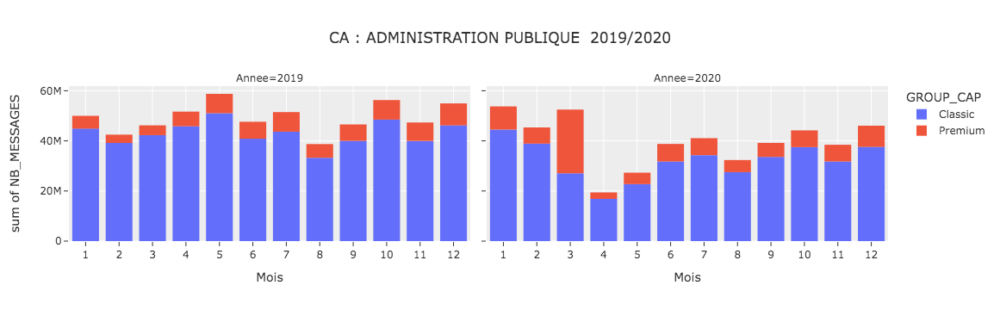

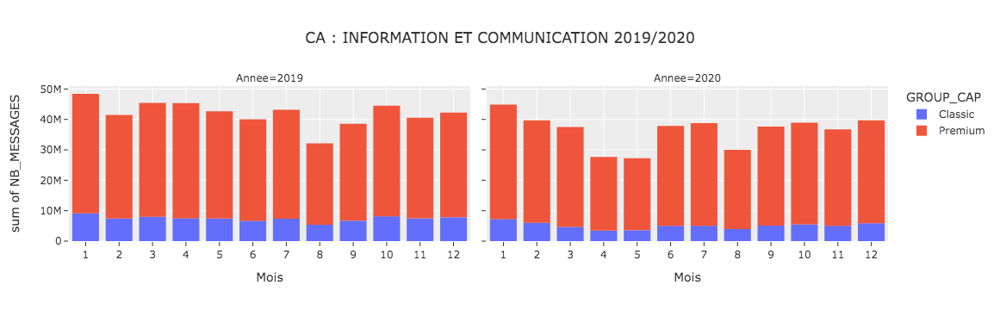

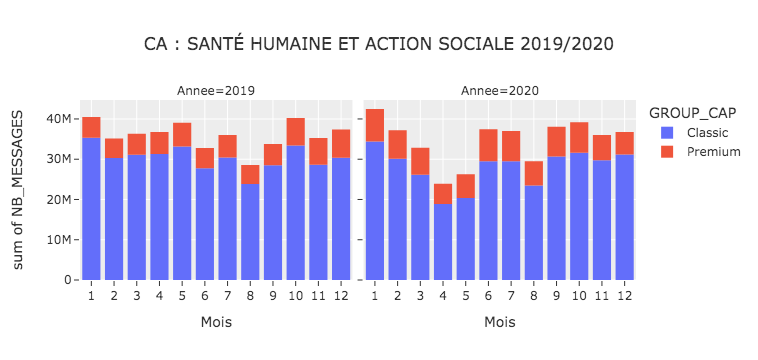

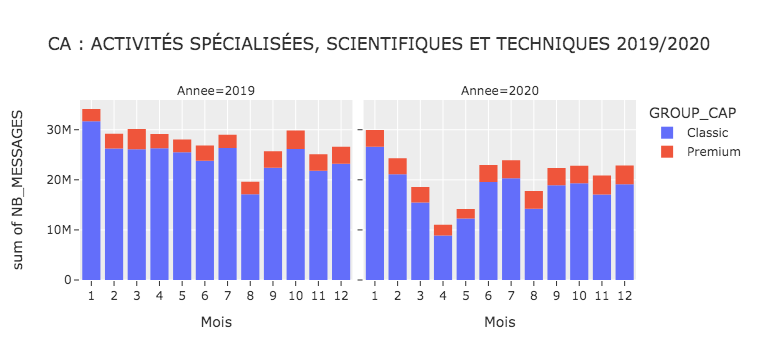

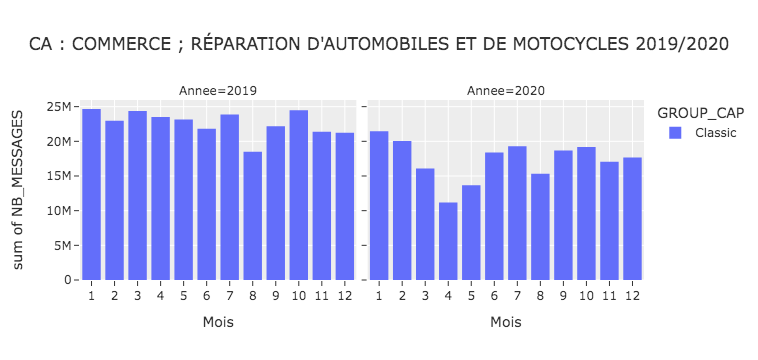

...

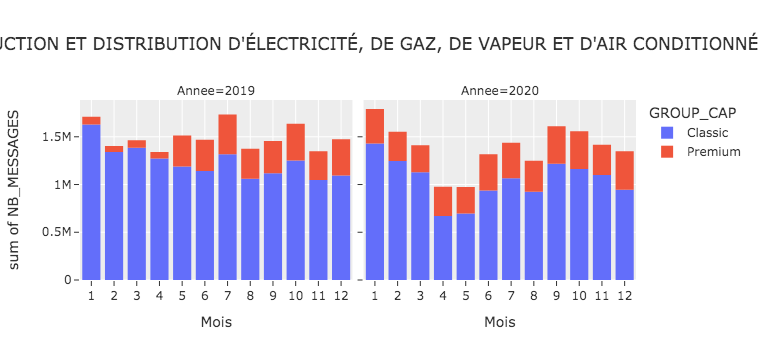

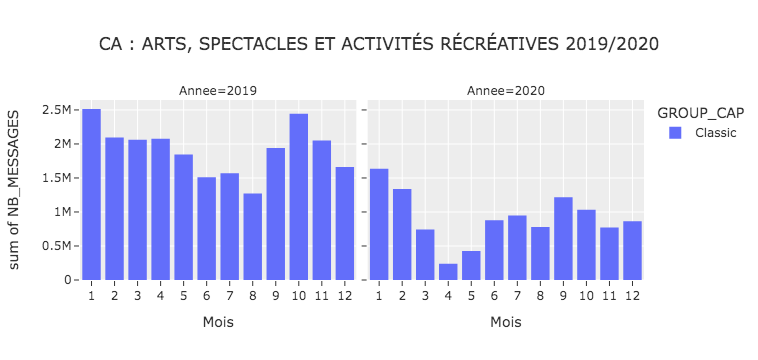

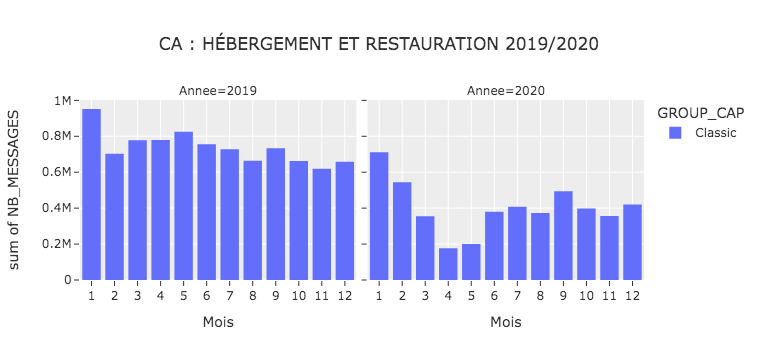

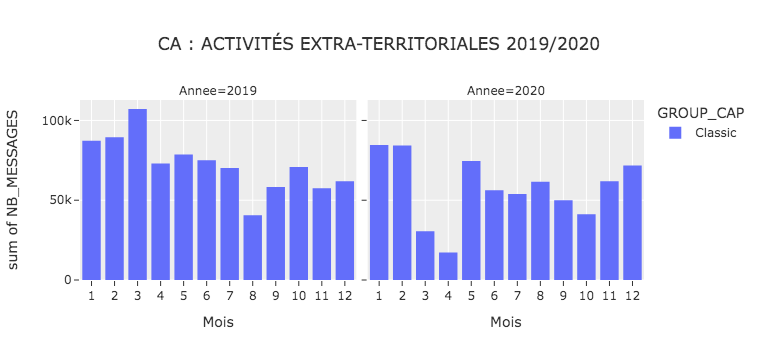

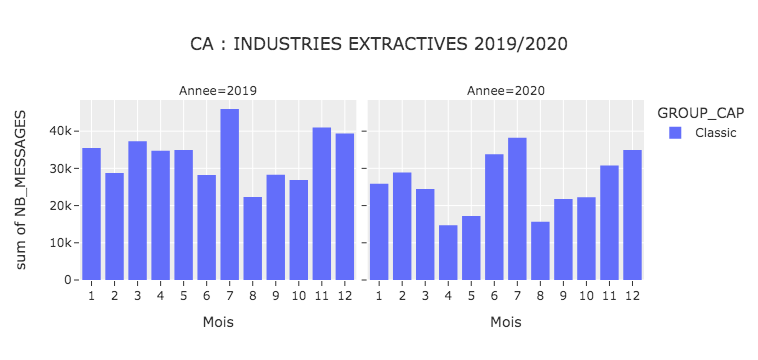

In [10]:
data = heartbeat_messages.groupby(['Annee','Mois','Section Desc','GROUP_CAP']).sum().reset_index()


for section in sections : 
    
    querydata = data.query(f""" `Section Desc` == "{str(section)}" """)  

    fig1 = px.histogram(querydata,
           x="Mois",
           y="NB_MESSAGES",
           color='GROUP_CAP',
           facet_col ="Annee",           
           histfunc='sum',
           title=f"CA : {section} 2019/2020",
           template='ggplot2',
           color_discrete_sequence=px.colors.qualitative.Plotly)
    
    fig1.update_xaxes(type='category')
    fig1.update_layout(hovermode="x")
    
    fig1.show()

### Active Users et NB messages par secteur d'activité 

In [11]:
data = heartbeat_messages.groupby(['Annee','Mois','Section Desc','GROUP_CAP']).sum().reset_index()

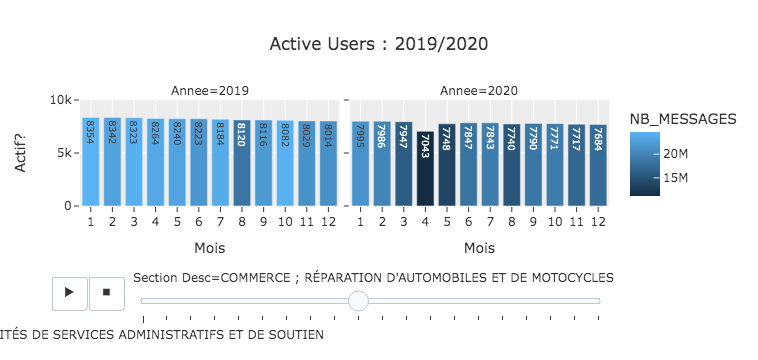

In [12]:
fig1 = px.bar(data,
           x="Mois",
           y="Actif?",
           color = 'NB_MESSAGES',
           facet_col='Annee',          
           title=f"Active Users : 2019/2020",
           template='ggplot2',
           animation_frame = "Section Desc",
           animation_group="Mois",
           color_discrete_sequence=px.colors.qualitative.Plotly,
           range_y=[0,10*10**3],
           text_auto=True) 
           

fig1.update_xaxes(type='category')
fig1.show()

### Synthèse Annuel des KPI'S

In [13]:
def human_format(num):
    num = float('{:.3g}'.format(num))
    magnitude = 0
    while abs(num) >= 1000:
        magnitude += 1
        num /= 1000.0
    return '{}{}'.format('{:f}'.format(num).rstrip('0').rstrip('.'), ['', 'K', 'M', 'B', 'T'][magnitude])


def annot(df):
    annot_arr=[]
    for i in range(df.shape[0]): 
        for j in range(df.shape[1]):
            annot_arr.append(human_format(df.iloc[i,j]))
        
    annot_arr = np.array(annot_arr).reshape(df.shape[0],df.shape[1])
    
    return annot_arr


def annot_percent(df):
    annot_arr=[]
    for i in range(df.shape[0]): 
        for j in range(df.shape[1]):
            annot_arr.append(str(df.iloc[i,j])+'%')
        
    annot_arr = np.array(annot_arr).reshape(df.shape[0],df.shape[1])
    
    return annot_arr

In [14]:
agg_year = pd.pivot_table(heartbeat_messages,
               values=['NB_MESSAGES'],
               index=['Section Desc'],
               columns=['Annee'],
               aggfunc= np.sum)

agg_year.columns = ['message2019','message2020']

In [15]:
pd.DataFrame(annot(agg_year.sort_values(by='message2020',ascending=False))
               				,columns=['message2019','message2020']
               				,index=agg_year.index)


,message2019,message2020
Section Desc,,
ACTIVITÉS DE SERVICES ADMINISTRATIFS ET DE SOUTIEN,592M,478M
ACTIVITÉS EXTRA-TERRITORIALES,505M,437M
ACTIVITÉS FINANCIÈRES ET D'ASSURANCE,432M,417M
ACTIVITÉS IMMOBILIÈRES,333M,252M
"ACTIVITÉS SPÉCIALISÉES, SCIENTIFIQUES ET TECHNIQUES",272M,208M
ADMINISTRATION PUBLIQUE,273M,197M
"AGRICULTURE, SYLVICULTURE ET PÊCHE",221M,166M
"ARTS, SPECTACLES ET ACTIVITÉS RÉCRÉATIVES",190M,146M
AUTRES ACTIVITÉS DE SERVICES,146M,112M


### Analyse et Conclusion

Le Covid étant arrivé courant 2020 il y'a des secteurs plus touché que d'autres en terme de volume de message envoyé et également en terme d'active users: 

- 24 janvier 2020: Le premier cas confirmé de COVID-19 en France est signalé à Bordeaux, impliquant un individu revenant de Wuhan, en Chine.

- 29 février 2020 : Le premier décès dû au COVID-19 est enregistré en France, marquant le début d'une augmentation rapide du nombre de décès dans les semaines à venir.

- 11 mars 2020 : L'Organisation mondiale de la santé (OMS) qualifie la propagation du COVID-19 de pandémie mondiale.

- 14 mars 2020 : Le gouvernement français déclare l'état d'urgence sanitaire, ce qui entraîne des mesures de confinement strictes dans tout le pays pour freiner la propagation du virus.

- 17 mars 2020 : Début de la mise en place du premier confinement en France, limitant les déplacements des citoyens et fermant les établissements scolaires, les commerces non essentiels et de nombreux lieux publics.

- 11 mai 2020 : Début du déconfinement progressif en France, avec une levée partielle des mesures restrictives et la réouverture de certains commerces et établissements.

- 30 octobre 2020 : Début du deuxième confinement en France, suite à une augmentation significative des cas de COVID-19. Des restrictions similaires au premier confinement sont mises en place.


**Mars et Mai 2020**

Les variations de l'activité correspondent aux réforme du gouvernement français qui déclare l'état d'urgence sanitaire notamment le premier confinement, tous les secteurs d'activité du client ont été touché sur le CA la logique de l'explication s'afffirme notamment sur certains secteur.

**Secteurs les plus touchés**

Certains secteurs ont connu une baisse significative du volume de messages de 2019 à 2020, ce qui peut être attribué à l'impact de la pandémie et aux mesures de confinement mises en place pour contenir la propagation du virus. Les secteurs les plus touchés en termes de baisse de volume de messages sont :

- **Hébergement et restauration** : Le volume de messages a diminué de 63,4 millions (M) en 2019 à 46,1 M en 2020. Les restrictions de déplacement et la fermeture des restaurants et hôtels ont eu un impact majeur sur ce secteur.

- **Arts, spectacles et activités récréatives** :
Le volume de messages a diminué de 196 M en 2019 à 151 M en 2020. Ce secteur a vu une augmentation le mois de Mars qui diminiue les données en moyenne mais ce sauvetage est induit par la clientèle Premium + présente ce mois-ci. Les mesures de distanciation sociale et la fermeture des lieux de divertissement ont fortement affecté ce secteur.


**Secteurs résilients**


Certains secteurs ont mieux résisté à la crise et ont même connu une légère augmentation du volume de messages malgré la pandémie

- **Santé humaine et action sociale** : Le volume de messages est passé de 870K en 2019 à 688K en 2020. En raison de la crise sanitaire, ce secteur a été fortement sollicité et a nécessité une communication accrue.
Activités financières et d'assurance : Bien que le volume de messages ait diminué de 577 M en 2019 à 445 M en 2020, ce secteur a relativement mieux résisté grâce à la continuité des services financiers essentiels.
Secteurs moins touchés : Certains secteurs ont également connu une diminution du volume de messages, mais dans une moindre mesure par rapport aux secteurs les plus touchés. Ces secteurs comprennent :

- **Activités de services administratifs et de soutien** : Le volume de messages est passé de 534 M en 2019 à 464 M en 2020. Malgré la baisse, ce secteur a maintenu une activité relativement stable grâce à la nécessité de continuer les services administratifs.

- **Activités spécialisées, scientifiques et techniques**: Le volume de messages a diminué de 293 M en 2019 à 226 M en 2020. Les services tels que la consultation et le conseil ont été affectés, mais certains domaines comme la technologie de l'information ont continué à être sollicités.


Ces observations suggèrent que la pandémie de COVID-19 a eu un impact significatif sur les secteurs qui dépendent largement des interactions sociales et des déplacements. Les secteurs du tourisme, de l'hôtellerie, du divertissement et des activités récréatives ont été les plus touchés en raison des restrictions imposées pour lutter contre la propagation du virus.






# Portefeuille client 

In [16]:
messages_agg_client.head(1)

,ID_CLIENT,DEP,NB_CONTRAT,Code_Naf,NB_SECTEURS,NB_EMPLOYEES_CLIENT,2019_1_Messages,2019_2_Messages,2019_3_Messages,2019_4_Messages,...,GROUP_CAP,Code Département,Code Département INSEE,Département,Code Région,Région,geo_point_2d,Code_Naf_Desc,Section Desc,Division Desc
0,909fed0564bb39263478eb48657a04ee,92.0,118,6311Z,1,4510.0,10371410.0,9118815.0,10347375.0,9916885.0,...,Premium,92.0,92.0,HAUTS-DE-SEINE,11.0,ILE-DE-FRANCE,"48.8960701282,2.20671346353","Traitement de données, hébergement et activité...",INFORMATION ET COMMUNICATION,Services d'information


In [17]:
def getLatLong(x,ax=0):
	try :
		return float(str(x).split(',')[ax])
	except :
         return np.nan

In [18]:
messages_agg_client['Lat'] = messages_agg_client['geo_point_2d'].apply(lambda x:getLatLong(x))

messages_agg_client['Lon'] = messages_agg_client['geo_point_2d'].apply(lambda x:getLatLong(x,1))

## Représentation Spatiale du portefeuille

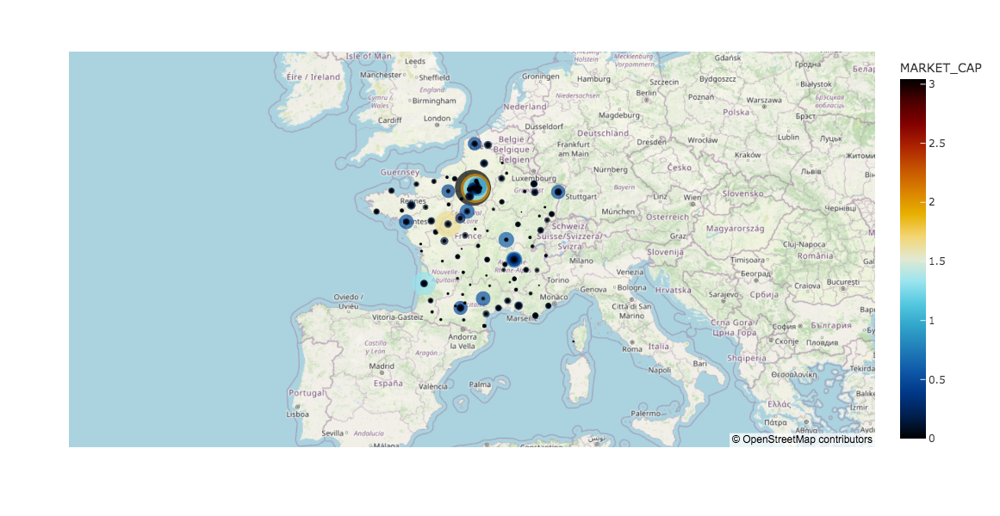

In [54]:
px.set_mapbox_access_token('pk.eyJ1IjoiYWRoYW0tZGF0YS1tYXAiLCJhIjoiY2w4MDZzOTlsMDM5czNvdDl4NXZxZWZ0cSJ9.JUvqDTyfwlNXDO-vIENIYA')


fig = px.scatter_mapbox(messages_agg_client, 
                        lat="Lat",
                        lon="Lon",
                        color="MARKET_CAP",
                        size='MESSAGE_TOTALE',
                  		color_continuous_scale=px.colors.cyclical.IceFire, 
                        size_max=30, 
                        zoom=4,
                        template='ggplot2'
                        )

fig.update_layout(mapbox=dict(bearing=0,center=dict(lat=44,lon=2),style = "open-street-map")
                  , width=800,height=600)
    
fig.show()

Une activité répartie de manière homogène sur le territoire français avec une concentration d'activité en terme de CA au niveau de la région **Ile-de-france**.

Cela signifie que les activités économiques sont réparties de manière relativement équilibrée dans tout le pays, mais que la région Île-de-France, qui comprend notamment Paris, concentre une part significative du chiffre d'affaires global.

Il est important de noter que cette formule est une généralisation et qu'elle peut varier en fonction des secteurs d'activité et des spécificités régionales. La région Île-de-France est connue pour abriter un grand nombre de sièges sociaux, d'entreprises internationales, d'institutions financières et de centres culturels, ce qui contribue à sa concentration d'activité économique.

## Typologie CLIENT

In [29]:
len(messages_agg_client['ID_CLIENT'])

56923

In [30]:
messages_agg_client['GROUP_CAP'].value_counts()

Classic    56836
Premium       87
Name: GROUP_CAP, dtype: int64

In [32]:
messages_agg_client['GROUP_CAP'].value_counts(normalize=True)*100

Classic    99.847162
Premium     0.152838
Name: GROUP_CAP, dtype: float64

In [81]:
messages_agg_client.groupby(['GROUP_CAP']).sum()['MARKET_CAP']

GROUP_CAP
Classic    72.827385
Premium    27.172615
Name: MARKET_CAP, dtype: float64

Au sein du portefeuille la classe Premium ne représentent que **0.15%** des clients cependant elle représente presque **1/3** du CA globale, on en déduit que le portefeuille du client est assez déséquilibrer, les clients ont des importances diamétralement opposé vis-à-vis du CA

In [21]:
messages_agg_client.groupby(['Section Desc']).sum()['MARKET_CAP']\
											 .sort_values(ascending=False)\
                   							 .to_frame()\
				   .join(messages_agg_client.groupby(['Section Desc'])\
                         				    .size()\
				   						    .sort_values(ascending=False)\
                   							.to_frame('NB_CLIENT'))
				    

,MARKET_CAP,NB_CLIENT
Section Desc,,
ADMINISTRATION PUBLIQUE,16.311140,5287
INFORMATION ET COMMUNICATION,14.340945,1060
SANTÉ HUMAINE ET ACTION SOCIALE,12.930013,3159
"ACTIVITÉS SPÉCIALISÉES, SCIENTIFIQUES ET TECHNIQUES",8.913627,8815
COMMERCE ; RÉPARATION D'AUTOMOBILES ET DE MOTOCYCLES,7.316234,8673
ACTIVITÉS FINANCIÈRES ET D'ASSURANCE,7.156264,4382
ACTIVITÉS DE SERVICES ADMINISTRATIFS ET DE SOUTIEN,5.905642,2868
INDUSTRIE MANUFACTURIÈRE,5.109171,5670
ACTIVITÉS IMMOBILIÈRES,3.933140,2057


Il est intéressant de noter que certaines sections d'activités 
ont une capitalisation élevée mais un nombre de clients relativement,
comme la section **"ADMINISTRATION PUBLIQUE"**


Certaines sections ont un nombre élevé de clients mais une capitalisation 
relativement faible, comme la section **"ACTIVITÉS EXTRA-TERRITORIALES"**
et la section **"INDUSTRIES EXTRACTIVES"**. Cela peut suggérer que ces secteurs ont un modèle économique
différent ou sont moins attractifs pour notre Activité (moins producteur de valeur)


On confirme encore une fois que le nombre de client appartenant à un secteur ne justifie pas son importance 
le modèle de rémunération de notre activité dépendant du volume de messages.

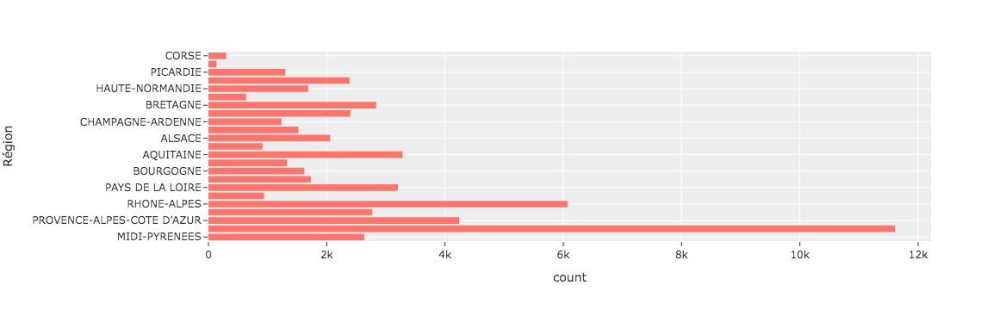

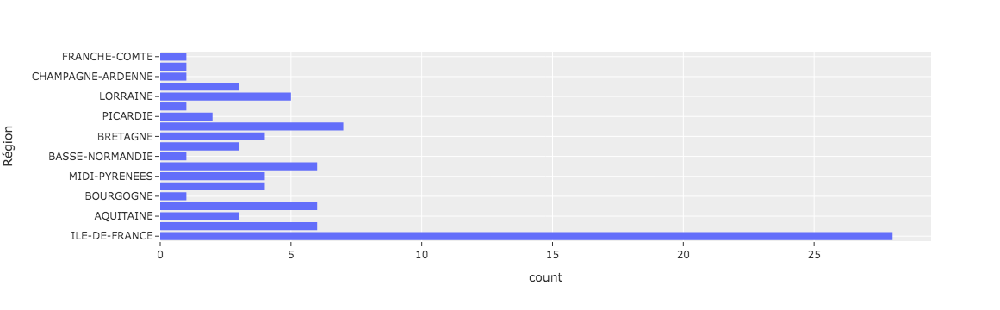

In [36]:
fig1 = px.histogram(messages_agg_client.query("GROUP_CAP== 'Classic'"), y='Région',template='ggplot2')

fig2 = px.histogram(messages_agg_client.query("GROUP_CAP== 'Premium'"),
                    y='Région',
                    template='ggplot2',
                    color_discrete_sequence=px.colors.qualitative.Plotly)
    

fig1.update_layout(hovermode="x unified")
fig2.update_layout(hovermode="x unified")

fig1.show()

fig2.show()

In [22]:
messages_agg_client.groupby(['GROUP_CAP'])[['NB_EMPLOYEES_CLIENT','NB_CONTRAT']].agg(["mean","std"]).T

GROUP_CAP                      Classic        Premium
NB_EMPLOYEES_CLIENT mean    256.313393   43300.000000
                    std   13624.871693  307190.504081
NB_CONTRAT          mean      1.692871      27.632184
                    std       3.888842      70.818654

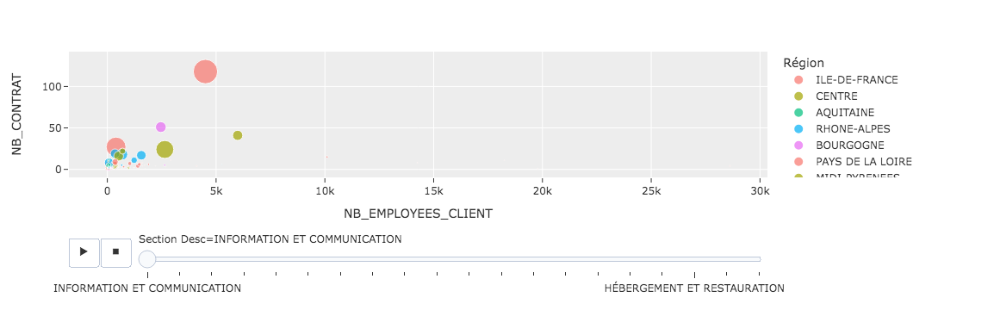

In [34]:
fig = px.scatter(messages_agg_client,
                 x="NB_EMPLOYEES_CLIENT", 
                 y="NB_CONTRAT",
                 size='MARKET_CAP',
                 color = 'Région',
                 template='ggplot2',
                 animation_frame='Section Desc')
fig.show()

# Proposition next steps

En tenant compte de cette analyse de l'activité de l'entreprise X, nous estimons que la clé pour obtenir une meilleure compréhension de l'activité ne réside pas nécessairement dans le développement de modèles complexes pour prévoir le nombre de messages d'un mois à l'autre, car la baisse est exclusivement attribuable, selon moi, à une source externe.

Nous suggérons plutôt de mettre en place un système de segmentation à l'aide d'un algorithme de clustering. Une fois cette segmentation établie, il serait judicieux de développer un modèle de classification basé sur ces groupes de segmentation afin de qualifier les nouveaux clients.

De plus, nous pourrions personnaliser les objectifs de l'activité en fonction de cette segmentation, ce qui apporterait une valeur ajoutée. En effet, connaître son client revient à connaître son entreprise.